In [21]:
import numpy as np
from numba import njit, prange
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

In [22]:
@njit
def init_state(n):
  return np.random.choice(np.array([-1,1]),size=(n,n))

In [23]:
def energy(state):
  N = state.shape[0]
  energy = 0

  for i in prange(N):
    for j in prange(N):
      nn = state[(i-1)%N, j] + state[(i+1)%N, j] + state[i, (j-1)%N] + state[i, (j+1)%N]
      energy -=  state[i,j] * nn
        
  return energy / 2 

## Energy

speed up with numba

In [24]:
@njit
def monte_carlo(state, beta):
  N = state.shape[0]

  i, j = np.random.randint(N), np.random.randint(N)
  nn = state[(i-1)%N, j] + state[(i+1)%N, j] + state[i, (j-1)%N] + state[i, (j+1)%N]
  delta = 2 * state[i,j] * nn

  if delta < 0 or np.random.random() < np.exp(- beta * delta):
    state[i,j] = -1. * state[i,j]
        
  return state

In [25]:
@njit
def Ising(N, beta, eq_steps = int(1e4), steps = int(1e6)):

    curr_state = init_state(N)
    M_eq = np.zeros(eq_steps)

    # pre-loop to equilibrate the system
    for i in prange(eq_steps):
        M_eq[i] = np.sum(curr_state)
        curr_state = monte_carlo(curr_state, beta)
    
    M = np.zeros(steps)
    # iterate over equilibrated Ising
    for i in prange(steps):
        M[i] = np.sum(curr_state)
        curr_state = monte_carlo(curr_state, beta)

    M_mean, Chi = np.mean(M), beta*np.std(M)**2
    M_var = np.std(M)

    return (M_mean, Chi, M_var, M_eq, M) 

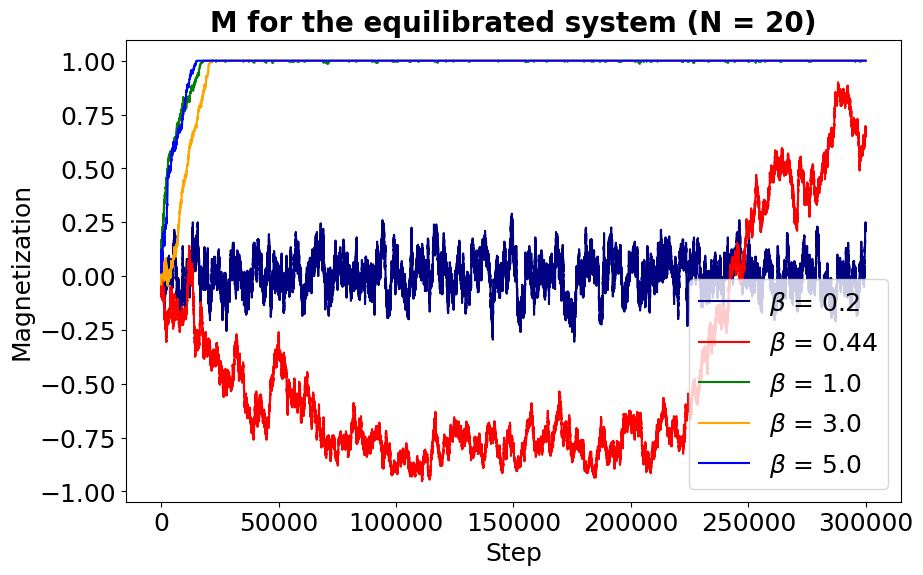

In [26]:
# Set up Simulation
N = 20
eq_steps = int(3e5)
steps = 100
betas = np.array([0.2, 0.44, 1, 3, 5]) 
col_map = np.array(["navy", "red", "green", "orange", "blue", "yellow"])

fig, (ax1) = plt.subplots(nrows = 1, figsize = (10, 6))
ax1.set_title(r"M for the equilibrated system (N = {})".format(N), fontweight = "bold", fontsize = 20)
ax1.set_xlabel("Step", fontsize = 18)
ax1.set_ylabel("Magnetization", fontsize = 18)
ax1.tick_params(axis="x",labelsize=18)
ax1.tick_params(axis="y",labelsize=18)

for i in range(len(betas)):    
    M_mean, Chi, M_var, M_eq, M = Ising(N, betas[i], eq_steps, steps)   
    ax1.plot(M_eq/N**2, label = r"$\beta$ = {}".format(betas[i]), c = col_map[i])
    
ax1.legend(fontsize = 18)
plt.show()

One sees that for $\beta = 0.2$ the system isn't able to reach a stable macroscopic magentization. On the other hand $\beta = {1, 3, 5}$ is able to equilibrate to either 1 or -1. For $\beta = 0.44$ the system skips from + to - magnetization back an forth, this obviously shows that we are close the critical temperature.

## Make an animation of the spins

In [27]:
# If 100x100 and steps \approx 1e6, the allocation is too big
# Thus I skip some steps for the actual implementation (see cell below)

@njit
def Ani_Ising_old(N, beta, eq_steps = int(1e4)):
    curr_state = init_state(N)
    M_eq = np.zeros(eq_steps)
    
    spin_configurations = np.zeros((eq_steps, N, N))
    
    for i in prange(eq_steps):
        M_eq[i] = np.sum(curr_state)
        curr_state = monte_carlo(curr_state, beta)
        spin_configurations[i] = curr_state
        
    return (M_eq, spin_configurations) 

In [28]:
@njit
def Ani_Ising(N, beta, eq_steps = int(1e4), resolution = int(1e2)):
    assert eq_steps > resolution
    total_steps = int(eq_steps/resolution)

    curr_state = init_state(N)
    
    M_eq = np.zeros(total_steps)
    spin_configurations = np.zeros((total_steps, N, N))
    
    for i in prange(total_steps):
        for j in prange(resolution):
                curr_state = monte_carlo(curr_state, beta)
            
        M_eq[i] = np.sum(curr_state)
        spin_configurations[i] = curr_state
        
    return (M_eq, spin_configurations) 

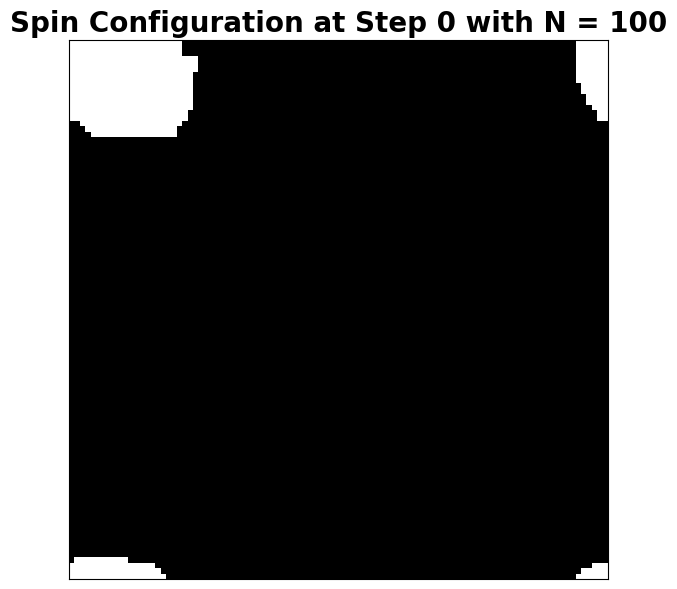

In [29]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

matplotlib.rcParams['animation.embed_limit'] = 100

N = 100
beta = 5
eq_steps = int(1e7) # number of total steps
resolution = int(1e4) # save only every n-th step

_, spin_configurations = Ani_Ising(N, beta, eq_steps, resolution)

# Make the actual animation
matplotlib.rcParams['animation.embed_limit'] = 100

fig, ax = plt.subplots(figsize=(9, 7), dpi=100)
mat = ax.matshow(spin_configurations[0], cmap=plt.cm.binary)
ax.set_xticks([])
ax.set_yticks([])
title = plt.title(f"Spin Configuration at Step 0 with N = {N}", fontsize=20, fontweight="bold")

num_frames = len(spin_configurations)

def update(frame):
    mat.set_data(spin_configurations[frame])
    return [mat, title]

ani = FuncAnimation(fig, update, frames=num_frames, interval=10, blit=True)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [30]:
#ani.save('N_200_steps_1e7_beta_5.mp4', writer='ffmpeg')

### That's a bit messy

In [31]:
N_list = np.arange(10, 71, 10, dtype=int)
eq_steps = int(3e6)
steps = int(1e4) 
betas = np.array([0.2, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 1]) #values of beta to be used

M_Mat = np.zeros((len(N_list), len(betas)))

for i in range(len(N_list)):
    for j in range(len(betas)):    
        M_mean, Chi, M_var, M_eq, M = Ising(N_list[i], betas[i], eq_steps, steps)   
        M_Mat[i][j] = np.abs(M_mean/N_list[i]**2)

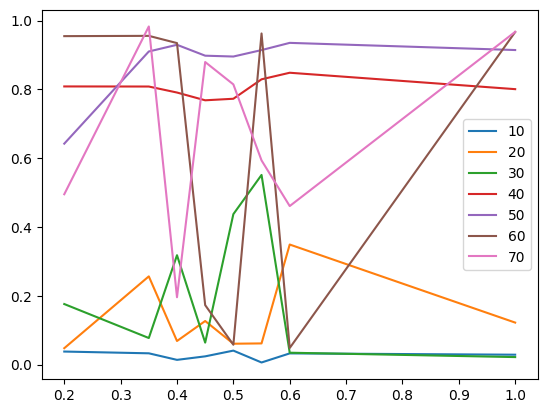

In [32]:
for i in range(len(N_list)):
    plt.plot(betas, M_Mat[i], label=str(N_list[i]))
    
plt.legend()
plt.show()